# Face and License Plate Blurring - AWS Marketplace Model Package

This Solution offers face and license plate blurring using deep learning detection.

This notebook assists you in deploying NavInfo Europe's Model Package from AWS Marketplace.
The example code below can be tailored to your needs, you can always revert back to the original code as provided by Navinfo Europe B.V.   
Knowledge of AWS and Python is assumed.

#### Pre-requisites:
1. **Note**: This notebook renders correctly in Jupyter interface. Open this notebook from an Amazon SageMaker Notebook Instance or Amazon SageMaker Studio.
1. Ensure that IAM role used has **AmazonSageMakerFullAccess**
1. To deploy this ML model successfully, ensure that:
    1. Your IAM role has these three permissions and you have authority to make AWS Marketplace subscriptions in the AWS account used: 
        1. **aws-marketplace:ViewSubscriptions**
        1. **aws-marketplace:Unsubscribe**
        1. **aws-marketplace:Subscribe**  
    2. Or your AWS account has a subscription to Face and License Plate Blurring. If so, skip step: [Subscribe to the model package](#1.-Subscribe-to-the-model-package)

#### Contents:
1. [Subscribe to the model package](#1.-Subscribe-to-the-model-package)
2. [Create the session](#2.-Create-Sagemaker-Session)
3. [Create an endpoint and perform real-time inference](#3.-Create-an-endpoint-and-perform-real-time-inference)
   1. [Create an endpoint](#A.-Create-an-endpoint)
   2. [Create input payload](#B.-Create-input-payload)
   3. [Perform real-time inference](#C.-Perform-real-time-inference)
   4. [Visualize output](#D.-Visualize-output)
   5. [Delete the endpoint](#E.-Delete-the-endpoint)
4. [Perform batch inference](#4.-Perform-batch-inference) 
5. [Clean-up](#5.-Clean-up)
    1. [Delete the model](#A.-Delete-the-model)
    2. [Unsubscribe to the listing (optional)](#B.-Unsubscribe-to-the-listing-(optional))
    

#### Usage instructions
You can run this Jupyter notebook one cell at a time. Press Shift+Enter for running each consecutive cell.

### 1. Subscribe to the model package

There are three ways to use the subscribed model package: Console, API and Sagemaker Python SDK.  
See https://docs.aws.amazon.com/sagemaker/latest/dg/sagemaker-mkt-model-pkg-model.html

For better visualisation, this notebook mainly uses Sagemaker Python SDK.  
For GPU instance usage, please use the Console or API methods as explained in the link above.

To subscribe to the model package:
1. Open the model package page ["Face and License Plate Blurring"](https://aws.amazon.com/marketplace/pp/prodview-qraiphwo2242e?ref_=beagle&applicationId=AWS-Sagemaker-Console).
1. Click on the **Continue to subscribe** button.
1. On the **Subscribe to this software** page, review and click on **"Accept Offer"** if you and your organization agree with the EULA, pricing, and support terms. 
1. Click on **Continue to configuration button** and then select a **region**. The **Product Arn** will now be displayed. This is the model package ARN that you need to specify while creating a deployable model using Boto3. Copy the ARN corresponding to your region in the following cell before you run it.

In [3]:
# Please update region (here eu-central-1 is default)
model_package_arn='arn:aws:sagemaker:eu-central-1:875741056133:model-package/anonymization-3-0-0'

### 2. Create Sagemaker Session

Boto is the Amazon Web Services (AWS) SDK for Python.   
Boto provides an easy to use, object-oriented API, as well as low-level access to AWS services.  
Boto creates a **session** to communicate with our model. This example uses the default (S3) **bucket**, which needs to be defined.

In [4]:
import sagemaker as sage
import os
import boto3
from sagemaker import get_execution_role
from sagemaker import transformer
from sagemaker import model

In [5]:
role = get_execution_role()

sagemaker_session = sage.Session()

bucket=sagemaker_session.default_bucket()
account=sagemaker_session.boto_session.client('sts').get_caller_identity()['Account']
region=sagemaker_session.boto_session.region_name

print(bucket)
print(account)
print(region)

sagemaker-eu-central-1-875741056133
875741056133
eu-central-1


### 3. Create a model

In [6]:
#Common definitions, needed for both real-time and batch transform inference
model_name='anonymization-v3-fastapi'

# Output blurred image MIME type
# Our model supports image/jpeg, image/png, image/bmp, image/dib, image/bmp, image/jp2, image/tiff
# This example uses jpeg
accept='image/jpeg'

# Input image MIME type
content_type='image/jpeg'


In [7]:
from sagemaker import ModelPackage
def predict_wrapper(endpoint, session):
    return sage.Predictor(endpoint, session)

#create a deployable model from the model package.
model = ModelPackage(role=role,
                    model_package_arn=model_package_arn,
                    sagemaker_session=sagemaker_session,
                    predictor_cls=predict_wrapper)
                    #env={"MODEL_SERVER_WORKERS": "30"})
# Remarks:
# Select right MODEL_SERVER_WORKERS number to maximize performance
# e.g. env={"MODEL_SERVER_WORKERS": "30"}
# https://sagemaker.readthedocs.io/en/stable/api/inference/model.html?highlight=modelpackage#sagemaker.model.Model

| Maximum value | g4dn.xlarge | g4dn.2xlarge | p2.xlarge | g4dn.4xlarge | g4dn.8xlarge | p3.2xlarge | p2.8xlarge | g4dn.12xlarge | g4dn.16xlarge | p3.8xlarge | p2.16xlarge | p3.16xlarge |
| --- | --- | --- | --- | --- | --- | --- | --- | --- | --- | --- | --- | --- |
| MODEL_SERVER_WORKERS | 4 | 8 | 4 | 13 | 13 | 8 | 32 | 30 | 13 | 32 | 64 | 64 |

### 4. Create an endpoint and perform real-time inference

This chapter explains how to:  
&nbsp;&nbsp;A. Create endpoint    
&nbsp;&nbsp;B. Prepare input data (images)    
&nbsp;&nbsp;C. Perform real-time inference     
&nbsp;&nbsp;D. Visualize output on this example page    
&nbsp;&nbsp;E. Clean up  

To understand how real-time inference with Amazon SageMaker works, see [Documentation](https://docs.aws.amazon.com/sagemaker/latest/dg/how-it-works-hosting.html).   
Note: Charging starts when the endpoint is created. To stop getting charged, you have to delete the endpoint.

#### A. Create an endpoint

In [23]:
# This example uses ml.g4dn.xlarge for slower but cheaper inference
real_time_inference_instance_type='ml.g4dn.xlarge'

#Deploy the model
predictor = model.deploy(1, real_time_inference_instance_type, endpoint_name=model_name)

-------------!

If there are errors while using this code for GPU instance usage, please use the Console or API methods, as explained in the link below.  
https://docs.aws.amazon.com/sagemaker/latest/dg/sagemaker-mkt-model-pkg-model.html

#### B. Create input payload

Together with this notebook, images are available in the data directory.

In [24]:
!pip install ipyplot
import ipyplot
import glob

ipyplot.plot_images(glob.glob('data/input/new/*.jpg'), max_images=20, img_width=150)

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/pytorch_p36/bin/python -m pip install --upgrade pip' command.


In [25]:
file_name = 'data/input/new/image10.jpg'
# file_name = 'data/input/real-time/lp_image5.jpg'

#### C. Perform real-time inference

Inference using GPU instances has a much better real-time inference speed performance.

CLI example:

In [26]:
output_file_name = 'data/output/real-time/output.jpg'

!aws sagemaker-runtime invoke-endpoint \
    --endpoint-name $model_name \
    --body fileb://$file_name \
    --content-type $content_type \
    --accept $accept \
    --region $sagemaker_session.boto_region_name \
    $output_file_name

{
    "ContentType": "image/jpeg",
    "InvokedProductionVariant": "AllTraffic"
}


Python example:

In [27]:
output_file_name = 'data/output/real-time/output.jpg'

# Open the file and read the image into a bytearray.
with open(file_name, "rb") as image:
    model_input = bytearray(image.read())
    # Perform a prediction
    response = predictor.predict(model_input)

try:
    with open(output_file_name, 'wb') as blurred_image_file:
        blurred_image_file.write(response)
except Exception as e:
    print(e)
    

#### D. Visualize output

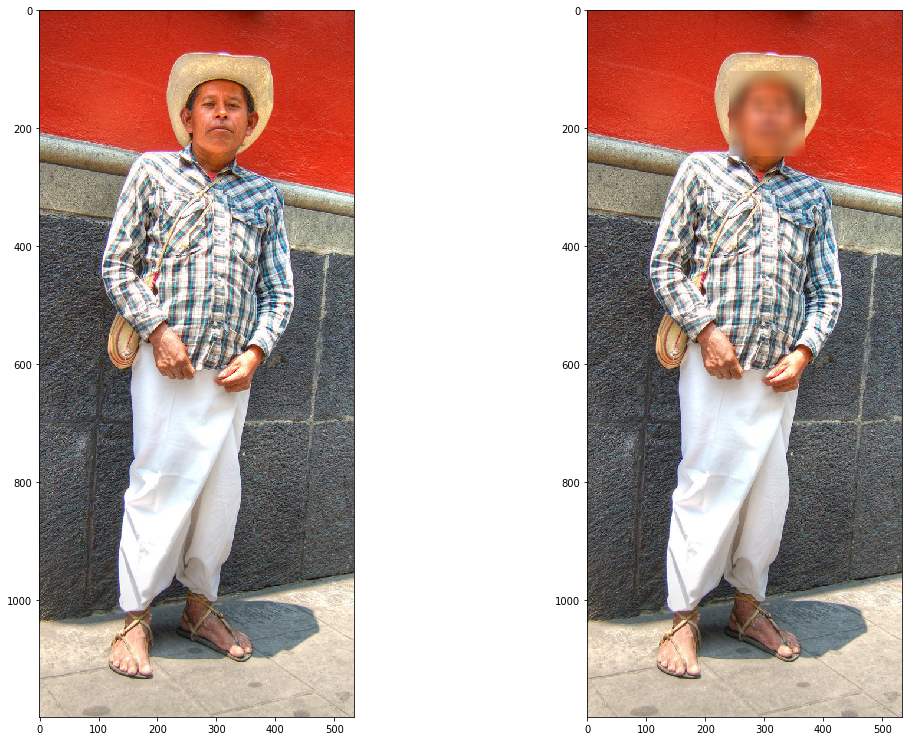

In [28]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib import rcParams

%matplotlib inline

# figure size in inches optional
rcParams['figure.figsize'] = 18 ,13

# read images
input_file = mpimg.imread(file_name)
output_file = mpimg.imread(output_file_name)

# display images
fig, ax = plt.subplots(1,2)
ax[0].imshow(input_file);
ax[1].imshow(output_file);

#### E. Realtime processing of a batch of images

In [14]:
import concurrent.futures
import threading
import time
thread_local = threading.local()
ORIG_FRAME_DIR = 'data/input/new/'
OUTPUT_DIR = 'data/output/real-time/'
SAGEMAKER_ENDPOINT = model_name

def blur_image(image):
    response = predictor.predict(image)
    return response

def blur_all_images(orig_file_list):
    with concurrent.futures.ThreadPoolExecutor(max_workers=4) as executor:
        jobs = []
        images = []
        results_done = []
        for idx, image_filename in enumerate(orig_file_list):
            with open(ORIG_FRAME_DIR + image_filename, 'rb') as image:
                model_input = bytearray(image.read())
                jobs.append(executor.submit(blur_image, model_input))
        for idx, job in enumerate(concurrent.futures.as_completed(jobs)):
            # Read result from future
            result_done = job.result()
            if idx < 20:
                with open(OUTPUT_DIR + str(idx) + ".jpg" , 'wb') as blurred_image_file:
                    blurred_image_file.write(result_done)

def threading_predict():
    orig_file_list = sorted(os.listdir(ORIG_FRAME_DIR))
    orig_file_list = orig_file_list * 1
    
    start_time = time.time()
    blur_all_images(orig_file_list)
    duration = time.time() - start_time
    print(f"Blurred {len(orig_file_list)} in {duration} seconds")
    
threading_predict()

Blurred 18 in 1.273902177810669 seconds


In [31]:
ipyplot.plot_images(glob.glob(OUTPUT_DIR + '*.jpg'), max_images=20, img_width=150)

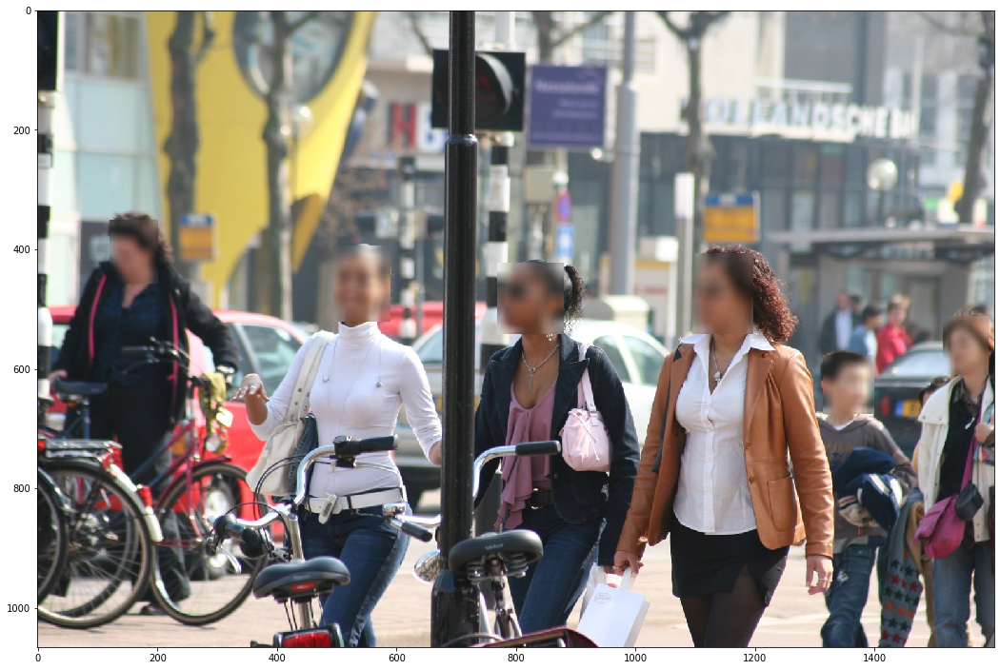

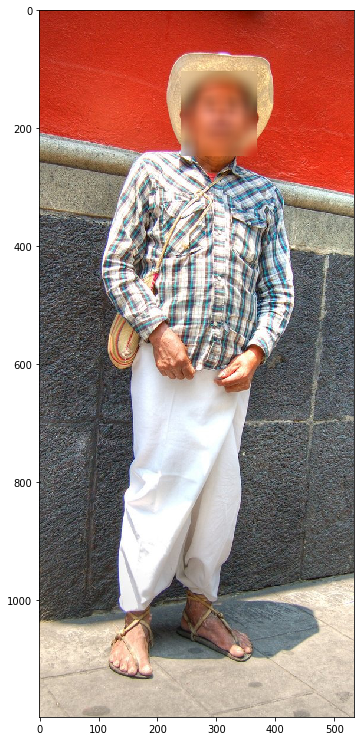

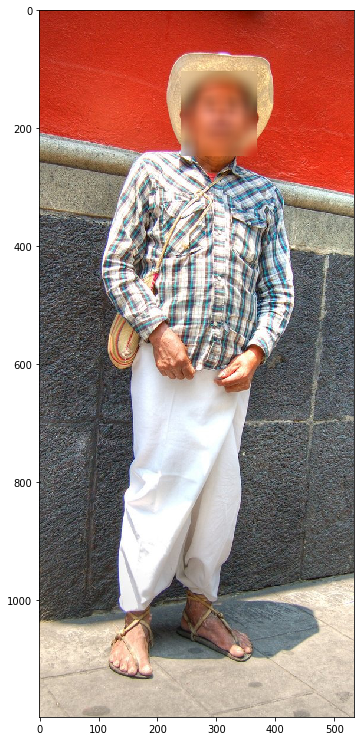

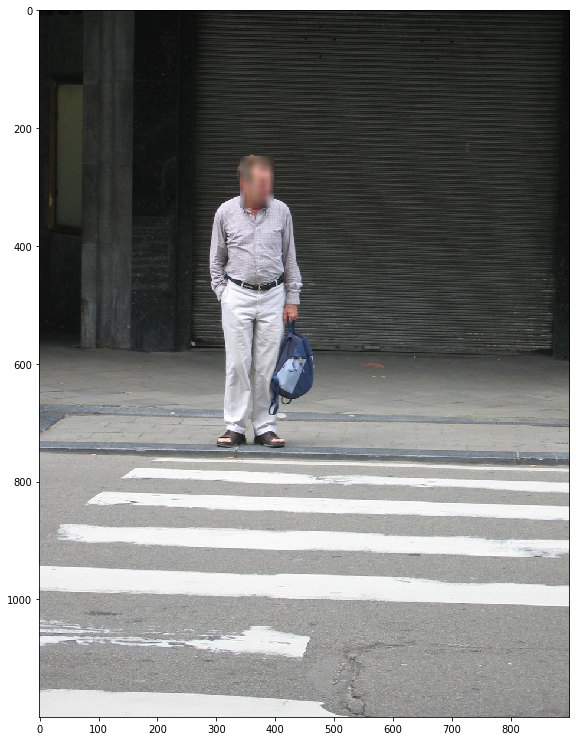

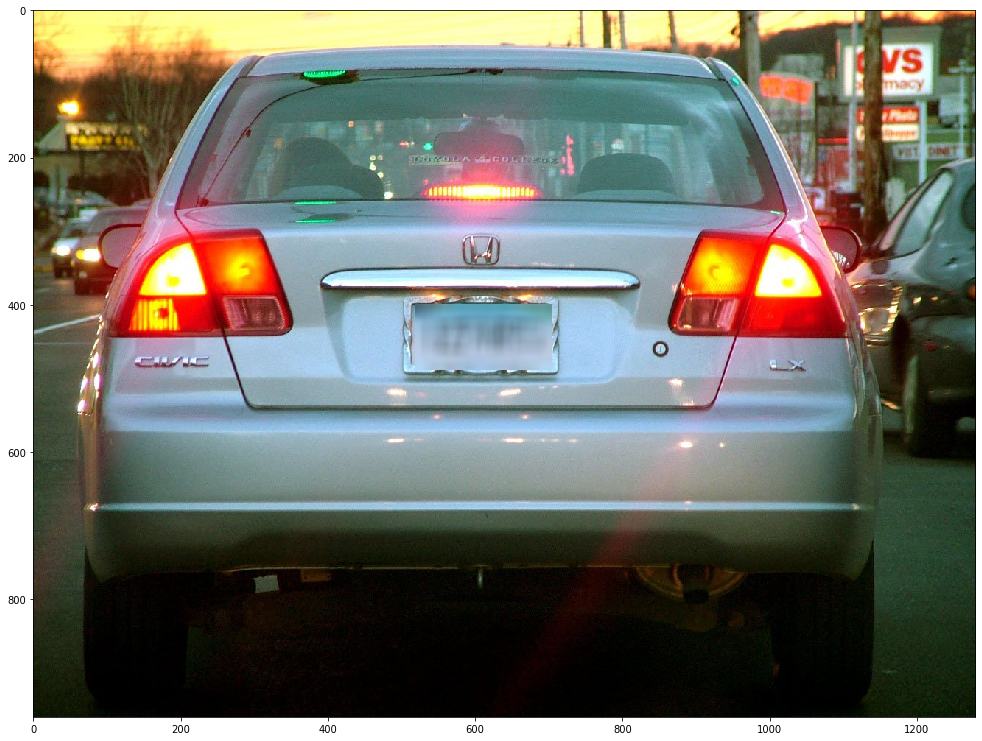

...

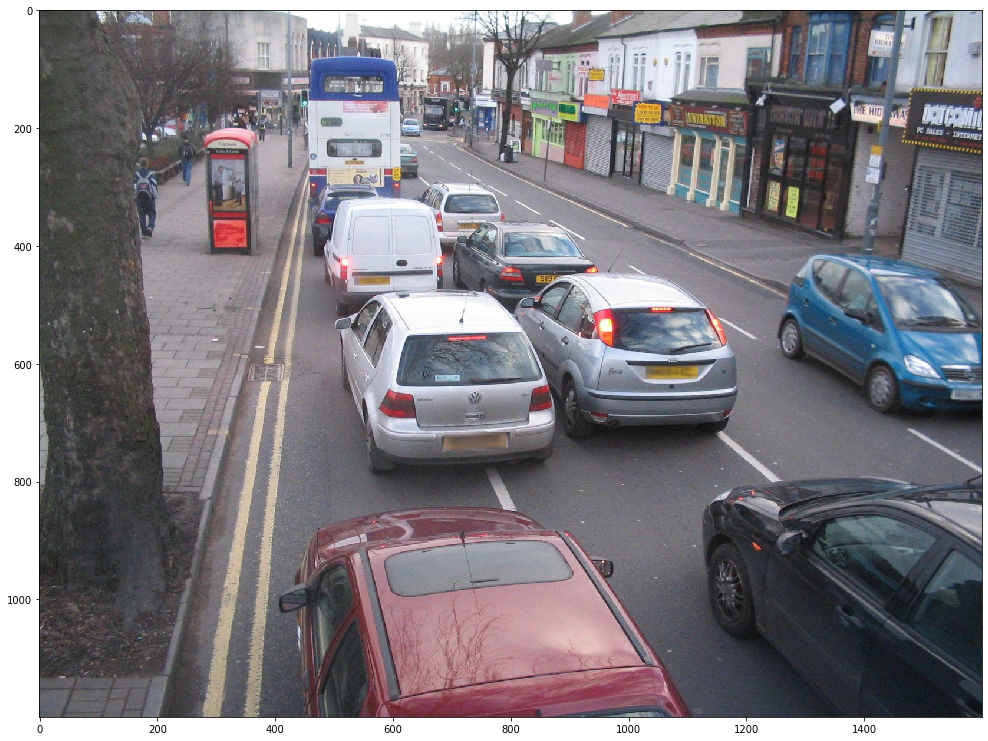

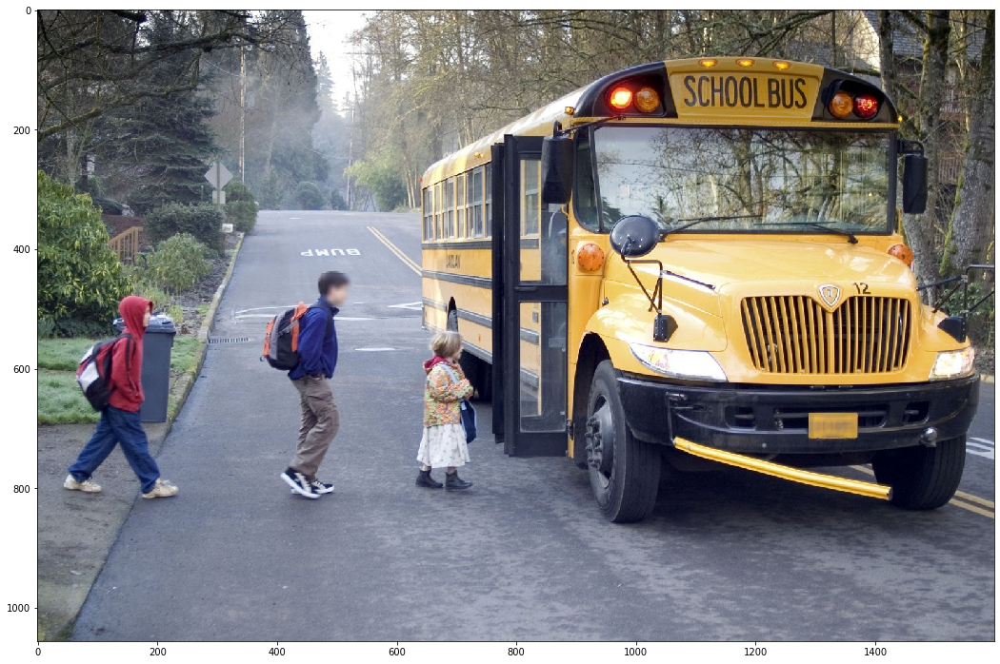

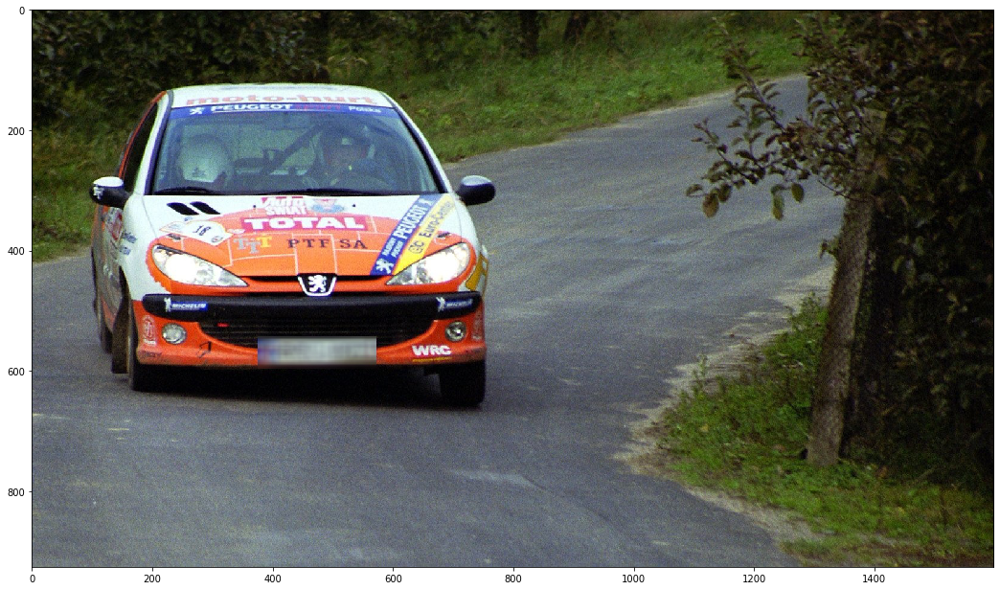

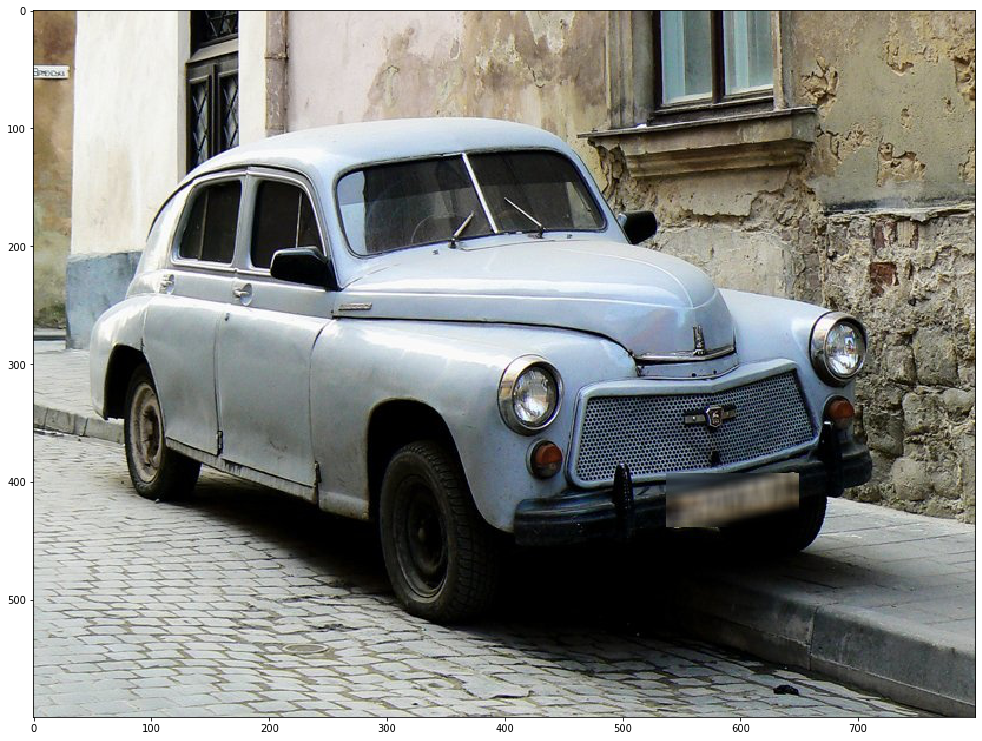

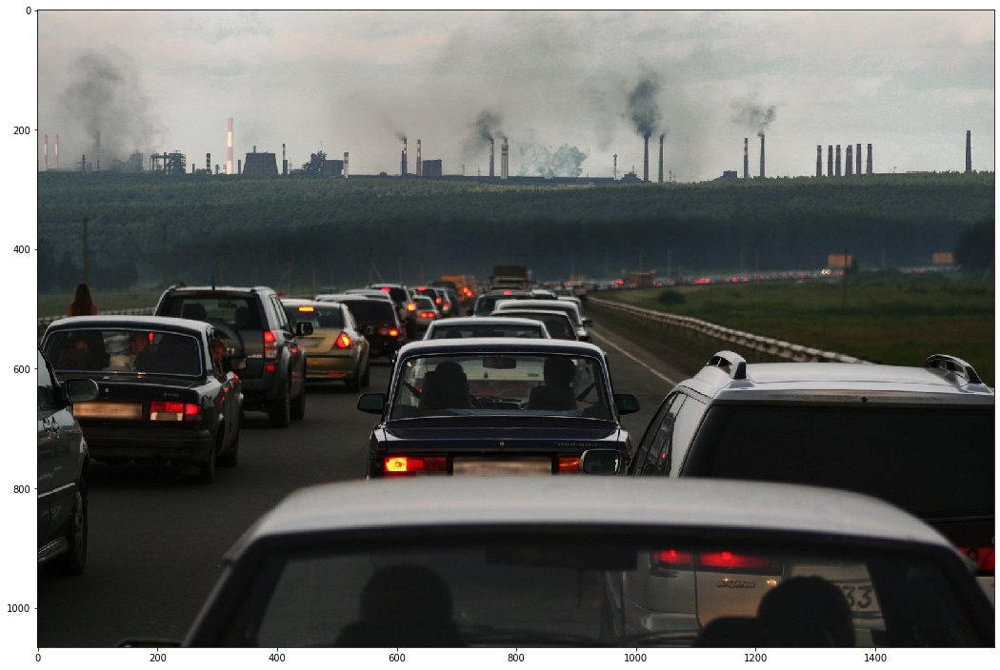

In [32]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
for imageName in glob.glob(OUTPUT_DIR + '*.jpg'):
    img = mpimg.imread(imageName)
    plt.figure()
    plt.imshow(img)

#### E. Delete the endpoint

Note: To stop getting charged, you have to delete the endpoint.

In [33]:
predictor=sage.Predictor(model_name, sagemaker_session,content_type)
predictor.delete_endpoint(delete_endpoint_config=True)

### 5. Perform batch inference

This chapter explains how to:  
&nbsp;&nbsp;A. Create input payload using S3    
&nbsp;&nbsp;B. Perform batch inference  
&nbsp;&nbsp;C. Retrieve output and visualize output on this example page    

Clean up is not required.

If you are not familiar with batch transform, and want to learn more, see these links:
1. [How it works](https://docs.aws.amazon.com/sagemaker/latest/dg/ex1-batch-transform.html)
2. [How to run a batch transform job](https://docs.aws.amazon.com/sagemaker/latest/dg/how-it-works-batch.html)

Inference using GPU instances has much better batch inference speed performance.   
You are only charged for the duration of the batch job. However each job will have to initialize, which takes additional time.

#### A. Create input payload (S3)

In [8]:
#upload the batch-transform job input files to S3
transform_input_folder = "data/input/new"
transform_input = sagemaker_session.upload_data(transform_input_folder, key_prefix=model_name) 
print("Transform input uploaded to " + transform_input)


Transform input uploaded to s3://sagemaker-eu-central-1-875741056133/anonymization-v3-fastapi


#### B. Perform batch inference

#### Update according to instance_type
#### I) MODEL_SERVER_WORKERS (above) and II) max_concurrent_transform (below)

| instance | p2.xlarge | p3.2xlarge | p2.8xlarge | p3.8xlarge | p2.16xlarge | p3.16xlarge |
| --- | --- | --- | --- | --- | --- | --- |
| MODEL_SERVER_WORKERS | 4 | 8 | 32 | 32 | 64 | 64 |
| max_concurrent_transforms | 4 | 8 | 32 | 32 | 64 | 64 |

In [9]:
# Support real time inference with ml.p2.xlarge (preferred)
batch_transform_inference_instance_type='ml.p2.xlarge'

transform_output_folder = "face_license_plate_blurring/batch_transform_output"
output_path = "s3://{}/{}".format(sagemaker_session.default_bucket(), transform_output_folder)

#Run the batch-transform job
#Output logging will be shown below
transformer = model.transformer(instance_count=1, 
                                instance_type=batch_transform_inference_instance_type,
                                output_path=output_path,
                                accept=accept,
                                max_concurrent_transforms=4) # [ACTION REQUIRED: value update base on instance]


transformer.transform(transform_input, content_type=content_type)
transformer.wait()

............................................2021-01-29 12:37:05,984 [INFO ] W-7-model.twin_engine - check engines status
2021-01-29 12:37:05,984 [INFO ] W-7-model.twin_engine - lp engine build - start
2021-01-29 12:37:05,985 [INFO ] W-7-model.trt_build_engine - Loading Onnx file from /home/ml/model/lp_detector.onnx
2021-01-29 12:37:07,005 [INFO ] W-7-model.trt_build_engine - Beginning ONNX file parsing
2021-01-29 12:37:07,044 [INFO ] W-7-model.trt_build_engine - Completed parsing of ONNX file
2021-01-29 12:37:07,044 [INFO ] W-7-model.trt_build_engine - Building an engine...
2021-01-29 12:37:40,299 [INFO ] W-7-model.trt_build_engine - Completed creating Engine
2021-01-29 12:37:40,393 [INFO ] W-7-model.trt_build_engine - Succesfully saved engine at /home/ml/model/lp_engine.trt
2021-01-29 12:37:40,393 [INFO ] W-7-model.twin_engine - lp engine build time: 34s
2021-01-29 12:37:40,394 [INFO ] W-7-model.twin_engine - face engine build - start
2021-01-29 12:37:40,394 [INFO ] W-7-model.trt_buil

2021-01-29 12:38:20,385 [INFO ] W-18-model.model_handler - accept type: image/jpeg
169.254.255.130 - - [29/Jan/2021:12:38:20 +0000] "POST /invocations HTTP/1.1" 200 143987 "-" "Go-http-client/1.1"
2021-01-29 12:38:20,474 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.013755559921264648, "faces_detection": 0.046968698501586914, "license_plates_detection": 0.014756917953491211, "blurring": 0.0007836818695068359, "image_imencode": 0.013185977935791016}, "faces_count": 8, "license_plates_count": 0, "image_width": 1024, "image_height": 768, "image_size_bytes": "184.0KiB"}
2021-01-29 12:38:20,474 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
2021-01-29 12:38:20,475 [INFO ] W-18-model.model_handler - accept type: image/jpeg
169.254.255.130 - - [29/Jan/2021:12:38:20 +0000] "POST /invocations HTTP/1.1" 200 188406 "-" "Go-http-client/1.1"
2021-01-29 12:38:20,590 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.024022340774536133, "fa

169.254.255.130 - - [29/Jan/2021:12:38:30 +0000] "POST /invocations HTTP/1.1" 200 100488 "-" "Go-http-client/1.1"
2021-01-29 12:38:30,336 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:38:30,423 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.01275491714477539, "faces_detection": 0.04621720314025879, "license_plates_detection": 0.014623641967773438, "blurring": 0.0006988048553466797, "image_imencode": 0.012581348419189453}, "faces_count": 2, "license_plates_count": 0, "image_width": 1024, "image_height": 768, "image_size_bytes": "130.5KiB"}
2021-01-29 12:38:30,423 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:38:30 +0000] "POST /invocations HTTP/1.1" 200 133655 "-" "Go-http-client/1.1"
2021-01-29 12:38:30,424 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:38:30,509 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.012860774993896484, "face

2021-01-29 12:38:40,329 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.012138128280639648, "faces_detection": 0.04697084426879883, "license_plates_detection": 0.014770984649658203, "blurring": 0.0007417201995849609, "image_imencode": 0.011563777923583984}, "faces_count": 7, "license_plates_count": 1, "image_width": 1024, "image_height": 683, "image_size_bytes": "146.9KiB"}
2021-01-29 12:38:40,330 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:38:40 +0000] "POST /invocations HTTP/1.1" 200 150407 "-" "Go-http-client/1.1"
169.254.255.130 - - [29/Jan/2021:12:38:40 +0000] "POST /invocations HTTP/1.1" 200 268650 "-" "Go-http-client/1.1"
2021-01-29 12:38:40,331 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:38:40,419 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.013834953308105469, "faces_detection": 0.04632067680358887, "license_plates_detection": 0.01460170745849609

2021-01-29 12:38:50,218 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.012215614318847656, "faces_detection": 0.04640603065490723, "license_plates_detection": 0.014977216720581055, "blurring": 0.00039315223693847656, "image_imencode": 0.012347936630249023}, "faces_count": 5, "license_plates_count": 0, "image_width": 1024, "image_height": 683, "image_size_bytes": "211.7KiB"}
2021-01-29 12:38:50,218 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
2021-01-29 12:38:50,219 [INFO ] W-18-model.model_handler - accept type: image/jpeg
169.254.255.130 - - [29/Jan/2021:12:38:50 +0000] "POST /invocations HTTP/1.1" 200 216801 "-" "Go-http-client/1.1"
169.254.255.130 - - [29/Jan/2021:12:38:50 +0000] "POST /invocations HTTP/1.1" 200 340249 "-" "Go-http-client/1.1"
2021-01-29 12:38:50,328 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.02376413345336914, "faces_detection": 0.04719376564025879, "license_plates_detection": 0.01453685760498046

2021-01-29 12:39:00,600 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.020058631896972656, "faces_detection": 0.04785513877868652, "license_plates_detection": 0.015016317367553711, "blurring": 0.00027751922607421875, "image_imencode": 0.021845102310180664}, "faces_count": 1, "license_plates_count": 0, "image_width": 1024, "image_height": 1270, "image_size_bytes": "218.3KiB"}
2021-01-29 12:39:00,600 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:39:00 +0000] "POST /invocations HTTP/1.1" 200 223491 "-" "Go-http-client/1.1"
2021-01-29 12:39:00,602 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:00,711 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.02235245704650879, "faces_detection": 0.04703664779663086, "license_plates_detection": 0.015315055847167969, "blurring": 0.00023794174194335938, "image_imencode": 0.023908138275146484}, "faces_count": 1, "license_plates

2021-01-29 12:39:15,382 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:15,483 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.011539697647094727, "faces_detection": 0.05830574035644531, "license_plates_detection": 0.018965721130371094, "blurring": 0.0006213188171386719, "image_imencode": 0.011829853057861328}, "faces_count": 3, "license_plates_count": 0, "image_width": 1024, "image_height": 682, "image_size_bytes": "164.7KiB"}
2021-01-29 12:39:15,484 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:39:15 +0000] "POST /invocations HTTP/1.1" 200 168612 "-" "Go-http-client/1.1"
169.254.255.130 - - [29/Jan/2021:12:39:15 +0000] "POST /invocations HTTP/1.1" 200 365552 "-" "Go-http-client/1.1"
2021-01-29 12:39:15,485 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:15,580 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.010650873184204102, "fac

2021-01-29 12:39:25,466 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:25,567 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.01284480094909668, "faces_detection": 0.0576174259185791, "license_plates_detection": 0.0177459716796875, "blurring": 0.0006887912750244141, "image_imencode": 0.011615753173828125}, "faces_count": 9, "license_plates_count": 0, "image_width": 1024, "image_height": 576, "image_size_bytes": "257.0KiB"}
2021-01-29 12:39:25,568 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
2021-01-29 12:39:25,568 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:25,676 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.012433767318725586, "faces_detection": 0.06301665306091309, "license_plates_detection": 0.01908588409423828, "blurring": 0.0001671314239501953, "image_imencode": 0.012614965438842773}, "faces_count": 1, "license_plates_count": 0, "image_width": 1024, "imag

169.254.255.130 - - [29/Jan/2021:12:39:30 +0000] "POST /invocations HTTP/1.1" 200 271017 "-" "Go-http-client/1.1"
2021-01-29 12:39:30,431 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:30,558 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.022549867630004883, "faces_detection": 0.058861732482910156, "license_plates_detection": 0.0175018310546875, "blurring": 0.0003409385681152344, "image_imencode": 0.02716231346130371}, "faces_count": 1, "license_plates_count": 0, "image_width": 1024, "image_height": 1556, "image_size_bytes": "261.5KiB"}
2021-01-29 12:39:30,558 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
2021-01-29 12:39:30,560 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:30,693 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.023501873016357422, "faces_detection": 0.05992722511291504, "license_plates_detection": 0.018306255340576172, "blurring": 0.001038074493408

2021-01-29 12:39:45,292 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:45,403 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.013996601104736328, "faces_detection": 0.06440305709838867, "license_plates_detection": 0.018775463104248047, "blurring": 0.00011372566223144531, "image_imencode": 0.013310670852661133}, "faces_count": 0, "license_plates_count": 1, "image_width": 1024, "image_height": 788, "image_size_bytes": "170.0KiB"}
2021-01-29 12:39:45,403 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:39:45 +0000] "POST /invocations HTTP/1.1" 200 174093 "-" "Go-http-client/1.1"
2021-01-29 12:39:45,404 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:45,292 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:45,403 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.013996601104736328, "faces_detection": 0.0644030570983


169.254.255.130 - - [29/Jan/2021:12:39:55 +0000] "POST /invocations HTTP/1.1" 200 162755 "-" "Go-http-client/1.1"
169.254.255.130 - - [29/Jan/2021:12:39:55 +0000] "POST /invocations HTTP/1.1" 200 289598 "-" "Go-http-client/1.1"
2021-01-29 12:39:55,435 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:55,554 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.021145343780517578, "faces_detection": 0.05661177635192871, "license_plates_detection": 0.018337488174438477, "blurring": 0.001970529556274414, "image_imencode": 0.021145343780517578}, "faces_count": 1, "license_plates_count": 1, "image_width": 1024, "image_height": 1344, "image_size_bytes": "142.0KiB"}
2021-01-29 12:39:55,554 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:39:55 +0000] "POST /invocations HTTP/1.1" 200 145361 "-" "Go-http-client/1.1"
2021-01-29 12:39:55,556 [INFO ] W-18-model.model_handler - accept type: image/jp

2021-01-29 12:37:05,984 [INFO ] W-7-model.twin_engine - check engines status
2021-01-29 12:37:05,984 [INFO ] W-7-model.twin_engine - lp engine build - start
2021-01-29 12:37:05,985 [INFO ] W-7-model.trt_build_engine - Loading Onnx file from /home/ml/model/lp_detector.onnx
2021-01-29 12:37:07,005 [INFO ] W-7-model.trt_build_engine - Beginning ONNX file parsing
2021-01-29 12:37:07,044 [INFO ] W-7-model.trt_build_engine - Completed parsing of ONNX file
2021-01-29 12:37:07,044 [INFO ] W-7-model.trt_build_engine - Building an engine...
2021-01-29 12:37:05,984 [INFO ] W-7-model.twin_engine - check engines status
2021-01-29 12:37:05,984 [INFO ] W-7-model.twin_engine - lp engine build - start
2021-01-29 12:37:05,985 [INFO ] W-7-model.trt_build_engine - Loading Onnx file from /home/ml/model/lp_detector.onnx
2021-01-29 12:37:07,005 [INFO ] W-7-model.trt_build_engine - Beginning ONNX file parsing
2021-01-29 12:37:07,044 [INFO ] W-7-model.trt_build_engine - Completed parsing of ONNX file
2021-01-2

169.254.255.130 - - [29/Jan/2021:12:38:36 +0000] "POST /invocations HTTP/1.1" 200 190291 "-" "Go-http-client/1.1"
2021-01-29 12:38:36,495 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.016617536544799805, "faces_detection": 0.04655575752258301, "license_plates_detection": 0.015500783920288086, "blurring": 0.00041031837463378906, "image_imencode": 0.015685558319091797}, "faces_count": 2, "license_plates_count": 0, "image_width": 1024, "image_height": 879, "image_size_bytes": "215.2KiB"}
2021-01-29 12:38:36,495 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:38:36 +0000] "POST /invocations HTTP/1.1" 200 220322 "-" "Go-http-client/1.1"
2021-01-29 12:38:36,496 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:38:36,583 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.012529373168945312, "faces_detection": 0.04669547080993652, "license_plates_detection": 0.0146162509918212

2021-01-29 12:39:03,631 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.014245986938476562, "faces_detection": 0.04682183265686035, "license_plates_detection": 0.014608621597290039, "blurring": 0.000396728515625, "image_imencode": 0.013067960739135742}, "faces_count": 7, "license_plates_count": 0, "image_width": 1024, "image_height": 750, "image_size_bytes": "170.8KiB"}
2021-01-29 12:39:03,631 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
2021-01-29 12:39:03,632 [INFO ] W-18-model.model_handler - accept type: image/jpeg
169.254.255.130 - - [29/Jan/2021:12:39:03 +0000] "POST /invocations HTTP/1.1" 200 174920 "-" "Go-http-client/1.1"
2021-01-29 12:39:03,721 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.01357722282409668, "faces_detection": 0.04642081260681152, "license_plates_detection": 0.015050411224365234, "blurring": 0.0002925395965576172, "image_imencode": 0.012963294982910156}, "faces_count": 1, "license_plates_count"

169.254.255.130 - - [29/Jan/2021:12:39:35 +0000] "POST /invocations HTTP/1.1" 200 160894 "-" "Go-http-client/1.1"
2021-01-29 12:39:35,288 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:35,395 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.011962652206420898, "faces_detection": 0.06412291526794434, "license_plates_detection": 0.019282102584838867, "blurring": 5.4836273193359375e-06, "image_imencode": 0.01144099235534668}, "faces_count": 0, "license_plates_count": 0, "image_width": 1024, "image_height": 682, "image_size_bytes": "142.2KiB"}
2021-01-29 12:39:35,396 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
169.254.255.130 - - [29/Jan/2021:12:39:35 +0000] "POST /invocations HTTP/1.1" 200 145616 "-" "Go-http-client/1.1"
169.254.255.130 - - [29/Jan/2021:12:39:35 +0000] "POST /invocations HTTP/1.1" 200 280147 "-" "Go-http-client/1.1"
2021-01-29 12:39:35,397 [INFO ] W-18-model.model_handler - accept type: image/jpe

2021-01-29 12:39:58,253 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.026495695114135742, "faces_detection": 0.05993485450744629, "license_plates_detection": 0.01976752281188965, "blurring": 0.0002720355987548828, "image_imencode": 0.02875494956970215}, "faces_count": 0, "license_plates_count": 3, "image_width": 1599, "image_height": 1066, "image_size_bytes": "287.4KiB"}
2021-01-29 12:39:58,253 [INFO ] W-18-uvicorn.access ACCESS_LOG - /- "POST /invocations http/1.0" 200
2021-01-29 12:39:58,254 [INFO ] W-18-model.model_handler - accept type: image/jpeg
2021-01-29 12:39:58,386 [INFO ] W-18-model.model_handler - {"timings": {"load_image": 0.0250704288482666, "faces_detection": 0.05820155143737793, "license_plates_detection": 0.019034147262573242, "blurring": 0.0007853507995605469, "image_imencode": 0.02849125862121582}, "faces_count": 6, "license_plates_count": 0, "image_width": 1600, "image_height": 1066, "image_size_bytes": "371.4KiB"}
2021-01-29 12:39:58,386 [INFO ] W

#### C. Retrieve and visualize output

In [10]:
#output is available on following path
transformer.output_path

's3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output'

In [16]:
!aws s3 sync s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output ./data/output/batch

download: s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output/image02.jpg.out to data/output/batch/image02.jpg.out
download: s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output/image03.jpg.out to data/output/batch/image03.jpg.out
download: s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output/image24.jpg.out to data/output/batch/image24.jpg.out
download: s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output/image09.jpg.out to data/output/batch/image09.jpg.out
download: s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output/image13.jpg.out to data/output/batch/image13.jpg.out
download: s3://sagemaker-eu-central-1-875741056133/face_license_plate_blurring/batch_transform_output/image11.jpg.out to data/output/batch/image11.jpg.out
download: s3://sagemaker-eu-central-1-875741056133/face_license_plate_

In [17]:
!pip install ipyplot
import ipyplot
import glob
ipyplot.plot_images(glob.glob('data/output/batch/*.jpg.out'), max_images=20, img_width=150)

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/pytorch_p36/bin/python -m pip install --upgrade pip' command.


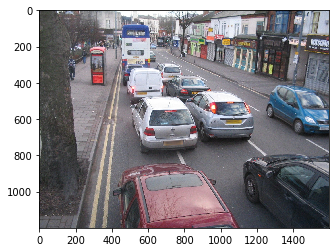

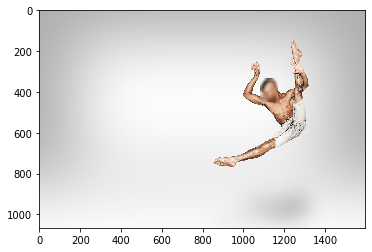

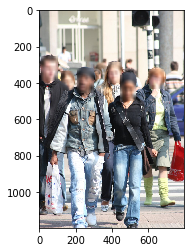

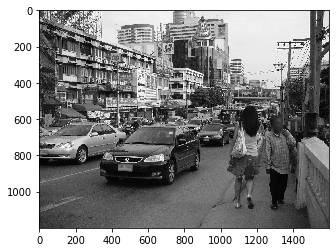

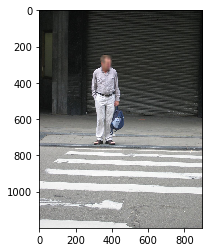

...

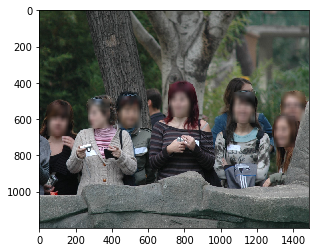

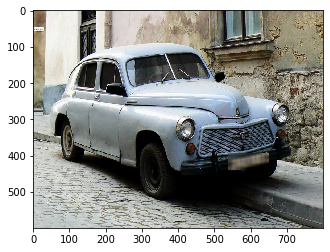

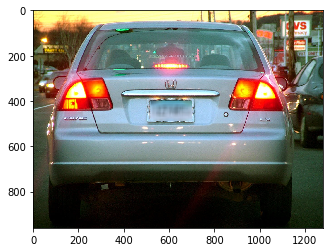

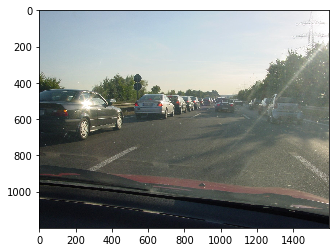

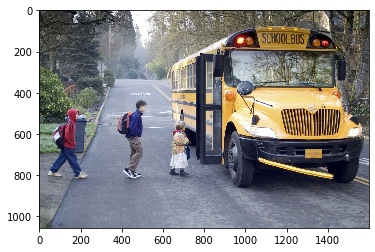

In [18]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
for imageName in glob.glob('data/output/batch/*.jpg.out'):
    img = mpimg.imread(imageName)
    plt.figure()
    plt.imshow(img)

### 6. Clean-up

#### A. Delete the model

In [19]:
model.delete_model()

#### B. Unsubscribe (optional)

To unsubscribe to the model package, follow these steps:   
Before you cancel the subscription, ensure that you do not have a [running model](https://console.aws.amazon.com/sagemaker/home#/models) or are using the algorithm.   
Note - You can find this information by looking at the container name associated with the model. 

**Steps to unsubscribe this product from AWS Marketplace**:
1. Navigate to __Machine Learning__ tab on [__Your Software subscriptions page__](https://aws.amazon.com/marketplace/ai/library?productType=ml&ref_=mlmp_gitdemo_indust)
2. Locate the listing that you want to cancel the subscription for, then choose __Cancel Subscription__  to cancel the subscription.


Sample dataset contains images from [freeimages.com ](www.freeimages.com)

In [37]:
rm -rf data/input/WIDER-1000